<a href="https://colab.research.google.com/github/tijazz/Image_Processing/blob/main/tomato_leaf_disease_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tomato Disease Detection Project

Welcome to my Tomato Disease Detection project! In this notebook, I'll walk you through the process and results of my project, where I developed a machine learning model to detect and classify diseases in tomato plants.

## Project Background

Tomato farming is essential for global food production, but it faces significant challenges due to various diseases that can affect tomato plants. Early detection and accurate classification of these diseases are crucial for crop management and ensuring food security.

## Dataset

I used a comprehensive dataset of tomato plant images, including examples of healthy plants and various disease states. This dataset serves as the foundation for training and evaluating my machine learning model.

## Project Goals

The primary objectives of this project are as follows:
- Build and train a machine learning model to accurately detect diseases in tomato plants.
- Classify the specific disease type if present.
- Evaluate the model's performance using appropriate metrics.

## Methodology

I will employ deep learning techniques, specifically convolutional neural networks (CNNs), for image classification. I'll also explore data preprocessing, model architecture, and fine-tuning to achieve the best possible results.

## Project Structure

This notebook is organized as follows:
1. Data Preparation: Exploring and preprocessing the dataset.
2. Model Development: Building and training the CNN model.
3. Model Evaluation: Assessing the model's performance and discussing the results.
4. Conclusion: Summarizing the findings and potential future work.

Let's get started with the project and dive into the fascinating world of tomato disease detection!


In [ ]:
import os
import warnings
warnings.filterwarnings("ignore")

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from sklearn.metrics import confusion_matrix
import numpy as np
import seaborn as sns

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.layers import InputLayer, BatchNormalization, Dropout, Flatten, Dense, Activation, MaxPooling2D, Conv2D
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import to_categorical
from keras import optimizers
from tensorflow.keras.optimizers import RMSprop
import matplotlib.pyplot as plt

from PIL import Image
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import keras.backend as K

from IPython.display import clear_output as cls
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

import scipy
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.applications.vgg19 import preprocess_input
from tensorflow.keras.preprocessing import image, image_dataset_from_directory
from tensorflow import keras

# Setting Paths for Training and Validation Data

In this project, we'll be working with a dataset of tomato leaf images to train and validate our machine learning model for tomato disease detection. To do this, we need to specify the paths to the folders containing our training and validation datasets.

The training data typically includes a large set of images used to train our model, while the validation data is used to assess the model's performance on unseen data.

Let's define the paths to our training and validation data folders:

- `train_path`: This path points to the directory containing our training data. These images will be used to train our model to recognize various tomato diseases.

- `valid_path`: This path leads to the folder with our validation data. The validation dataset is crucial for evaluating how well our trained model generalizes to new, unseen tomato leaf images.

Now that we've set the paths to our data, we can proceed to load and preprocess the images, build our model, and begin training it to detect tomato diseases.


In [ ]:
##Mount Google Drive:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
#Unzip the zipped file into the Google drive folder
## Run only once

!unzip "/content/drive/My Drive/Image Processing DL/tomato.zip" -d "/content/drive/My Drive/Image Processing DL/tomatoes"

In [ ]:
# Set paths to train and validation folders
train_path = "/content/drive/MyDrive/Image Processing DL/tomatoes/tomato/train"
valid_path = "/content/drive/MyDrive/Image Processing DL/tomatoes/tomato/val"

In [ ]:
#for kaggle notebook
# Set paths to train and validation folders
train_path = "/kaggle/input/tomatoleaf/tomato/train"
valid_path = "/kaggle/input/tomatoleaf/tomato/val"

# Data Preprocessing with ImageDataGenerator

To effectively train a deep learning model for tomato disease detection, it's crucial to prepare and preprocess the dataset appropriately. In this section, we'll discuss the data preprocessing steps using the `ImageDataGenerator` from Keras.

The following code sets up our data preprocessing pipeline:

- `image_size`: We define the desired image size for our dataset. In this case, we've set it to (224, 224) pixels, a common choice for many deep learning models.

- `batch_size`: This parameter determines the number of images processed in each training iteration. A batch size of 32 means that the model will update its weights after processing 32 images.

- `train_datagen`: Here, we configure an `ImageDataGenerator` for augmenting and preprocessing the training images. These transformations help enhance the model's ability to generalize from the limited training data. The specific operations include:
    - `rescale=1.0/255`: Scaling pixel values to the range [0, 1] to ensure consistent input to the model.
    - `rotation_range=20`: Randomly rotating images by up to 20 degrees to introduce variety.
    - `width_shift_range=0.2` and `height_shift_range=0.2`: Shifting the image horizontally and vertically by up to 20% of the image width or height, respectively.
    - `shear_range=0.2`: Applying shear transformations to the images.
    - `zoom_range=0.2`: Zooming in or out on images by up to 20%.
    - `horizontal_flip=True`: Flipping images horizontally, which increases data diversity.

These preprocessing steps, such as rotation, shifting, and flipping, will help our model become more robust and better at detecting tomato diseases in various conditions. With the data preprocessing pipeline in place, we're ready to load the dataset, create data generators, and start training our model.


In [ ]:
# Define image data generators with data augmentation
image_size = (224, 224)
batch_size = 32
train_datagen = ImageDataGenerator(
    rescale=1.0/255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.2
)

In [ ]:
valid_datagen = ImageDataGenerator(rescale=1.0/255)

In [ ]:
classes = os.listdir(train_path)

In [ ]:
classes

['Tomato___Late_blight',
 'Tomato___healthy',
 'Tomato___Early_blight',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Bacterial_spot',
 'Tomato___Target_Spot',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___Leaf_Mold',
 'Tomato___Spider_mites Two-spotted_spider_mite']

# Creating Data Generators for Training and Validation

Now that we've defined our data preprocessing pipeline using `ImageDataGenerator`, the next step is to create data generators for both our training and validation datasets. These data generators will efficiently load and augment the data, making it ready for training our tomato disease detection model.

Here's how we set up the data generators:

- `train_generator`: We create a data generator for our training dataset using the `flow_from_directory` method. This generator will load images from the `train_path`, which we defined earlier, and perform the following actions:
    - `directory`: Specifies the directory where the training images are located.
    - `target_size`: Sets the desired image size, which we previously defined as (224, 224) pixels.
    - `batch_size`: Determines the number of images processed in each training iteration, and we've set it to 32.
    - `class_mode`: We specify "categorical" as the class mode, indicating that our model will predict categories (disease classes) using one-hot encoding.

- `valid_generator`: Similarly, we create a data generator for our validation dataset using the same `flow_from_directory` method. This generator loads images from the `valid_path` and applies the same settings as the training generator.

These data generators are crucial for training and evaluating our model efficiently. They handle the loading of images, apply the data augmentation transformations defined earlier, and organize the data into batches. This setup allows us to feed the data seamlessly to our model during the training process.

With the data generators in place, we're one step closer to building and training our tomato disease detection model effectively.


In [ ]:
train_generator = train_datagen.flow_from_directory(
    directory=train_path,
    target_size=image_size,
    batch_size=batch_size,
    class_mode="categorical",
    seed=123,
    subset='training'
)

Found 8000 images belonging to 10 classes.


In [ ]:
test_generator = train_datagen.flow_from_directory(
    directory=train_path,
    target_size=image_size,
    batch_size=batch_size,
    class_mode="categorical",
    seed=123,
    subset='validation'
)

Found 2000 images belonging to 10 classes.


In [ ]:
valid_generator = valid_datagen.flow_from_directory(
    directory=valid_path,
    target_size=image_size,
    batch_size=batch_size,
    class_mode="categorical"
)

Found 1000 images belonging to 10 classes.


# Displaying Random Images from Dataset Subfolders

In the process of working with image datasets, it's essential to get a visual sense of the data. This code snippet provides a utility function, `display_random_images`, that allows us to display a random selection of images from subfolders within a specified directory. This can be particularly useful for exploring the diversity and content of our tomato disease dataset.


- `display_random_images(directory, num_images=9, num_columns=3)`: This is the main function. It takes three parameters:
    - `directory`: The directory where the dataset subfolders are located.
    - `num_images` (optional, default=9): The number of random images to display.
    - `num_columns` (optional, default=3): The number of columns in the display grid.

The function performs the following steps:
1. It identifies subfolders within the specified directory.
2. Randomly selects one of these subfolders.
3. Lists the image files within the chosen subfolder.
4. Randomly selects `num_images` from the available images.
5. Creates a grid for displaying the selected images, arranging them in rows and columns.
6. Displays the images with their filenames as titles.

This utility function can help you visually inspect your dataset, ensuring that it contains a diverse set of images representing different classes or categories. It's also a handy tool for data exploration and quality control.

To use this function in your notebook, simply call `display_random_images` with the appropriate directory containing your tomato disease images and the desired number of images to display.


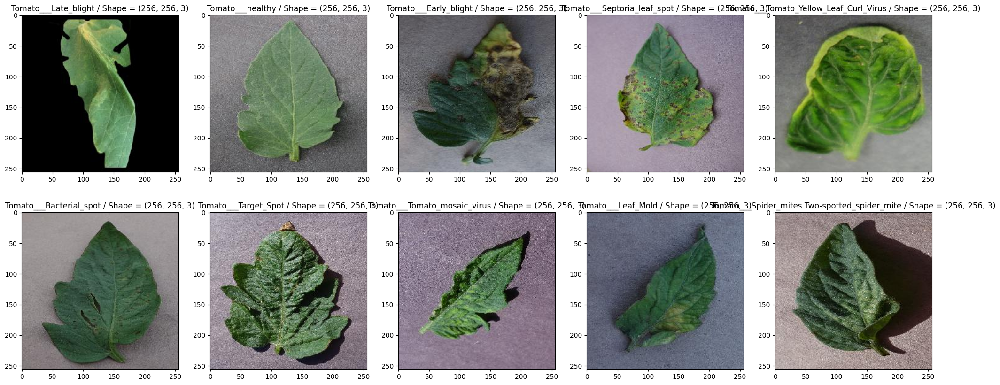

In [ ]:
#Training data visualization
train_path
classes = os.listdir(train_path)

plt.figure(figsize=(25,10))

for i in enumerate(classes):
    pic = os.listdir(train_path+'/'+i[1])[0]
    image = Image.open(train_path+'/'+i[1]+'/'+pic)
    image = np.asarray(image)
    plt.subplot(2,5,i[0]+1)
    plt.title('{0} / Shape = {1}'.format(i[1], image.shape))
    plt.imshow(image)
plt.show()

In [ ]:
def display_random_images(directory, num_images=9, num_columns=3):
    subfolders = [subfolder for subfolder in os.listdir(directory) if os.path.isdir(os.path.join(directory, subfolder))]
    if len(subfolders) == 0:
        print(f"No subfolders found in {directory}")
        return

    random_subfolder = random.choice(subfolders)
    subfolder_path = os.path.join(directory, random_subfolder)
    image_files = [filename for filename in os.listdir(subfolder_path) if filename.lower().endswith(('.png', '.jpg', '.jpeg'))]
    if len(image_files) < num_images:
        print(f"Number of available images in {subfolder_path} is less than {num_images}")
        return

    random_files = random.sample(image_files, num_images)
    num_rows = (num_images + num_columns - 1) // num_columns
    plt.figure(figsize=(15, 10))

    for i, filename in enumerate(random_files):
        img_path = os.path.join(subfolder_path, filename)
        img = mpimg.imread(img_path)
        plt.subplot(num_rows, num_columns, i + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(filename)

    plt.tight_layout()
    plt.show()

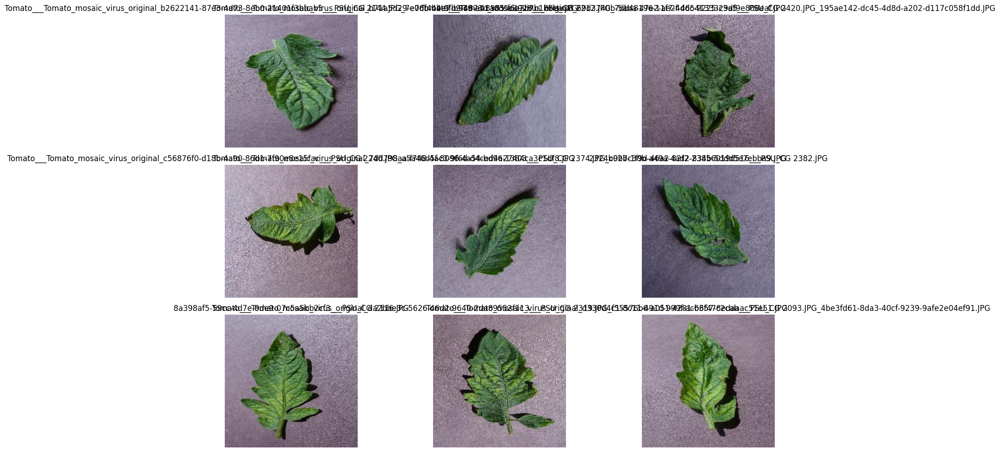

In [ ]:
# Call the function with the desired directory and number of images
display_random_images(train_path, num_images=9, num_columns=3)


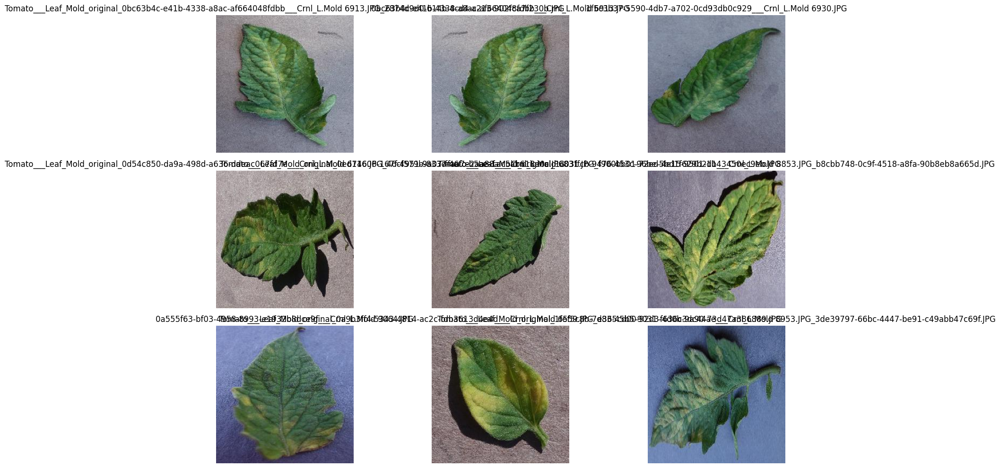

In [ ]:
# Call the function with the desired directory and number of images
display_random_images(valid_path, num_images=9, num_columns=3)


#Defining the Model's Evaluation Metrics

In [ ]:
METRICS = [
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),
      tf.keras.metrics.AUC(name='auc')

]

In [ ]:
def predictImages(data, class_names, model):

    r, c = 3, 4
    imgLen = r*c
    plt.figure(figsize=(20, 15))
    i = 1

    for images, labels in iter(data):

        id = np.random.randint(len(images))
        img = tf.expand_dims(images[id], axis=0)

        plt.subplot(r, c, i)
        plt.imshow(img[0])

        predicted = model.predict(img)
        predicted = class_names[np.argmax(predicted)]
        actual = class_names[np.argmax(labels[id])]
        #confidence = np.max(output()[0])*100

        plt.title(f"Actual: {actual}\nPredicted: {predicted}")
        plt.axis('off')
        cls()

        i+=1
        if i > imgLen:
            break

    plt.show()

In [ ]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.01, 5) # when i run it for 50 epochs

lr_scheduler = tf.keras.callbacks.LearningRateScheduler(exponential_decay_fn)

In [ ]:
#%% PLOTTING RESULTS (Train vs Validation FOLDER 1)

def Train_Val_Plot(acc,val_acc,loss,val_loss,auc,val_auc,precision,val_precision):

    fig, (ax1, ax2,ax3,ax4) = plt.subplots(1,4, figsize= (20,5))
    fig.suptitle(" MODEL'S METRICS VISUALIZATION ")

    ax1.plot(range(1, len(acc) + 1), acc)
    ax1.plot(range(1, len(val_acc) + 1), val_acc)
    ax1.set_title('History of Accuracy')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Accuracy')
    ax1.legend(['training', 'validation'])


    ax2.plot(range(1, len(loss) + 1), loss)
    ax2.plot(range(1, len(val_loss) + 1), val_loss)
    ax2.set_title('History of Loss')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Loss')
    ax2.legend(['training', 'validation'])

    ax3.plot(range(1, len(auc) + 1), auc)
    ax3.plot(range(1, len(val_auc) + 1), val_auc)
    ax3.set_title('History of AUC')
    ax3.set_xlabel('Epochs')
    ax3.set_ylabel('AUC')
    ax3.legend(['training', 'validation'])

    ax4.plot(range(1, len(precision) + 1), precision)
    ax4.plot(range(1, len(val_precision) + 1), val_precision)
    ax4.set_title('History of Precision')
    ax4.set_xlabel('Epochs')
    ax4.set_ylabel('Precision')
    ax4.legend(['training', 'validation'])



    plt.show()


In [ ]:
num_classes = len(train_generator.class_indices)

# MODEL BUILDING : CNN with 1 Convolutional Layer (1 — 1-Conv CNN)

In [ ]:
def build_model():

    '''Sequential Model creation'''
    model = Sequential()
    model.add(Conv2D(32,(3,3),padding='same',strides=(3, 3),input_shape = (224,224,3),activation='relu'))


    model.add(MaxPooling2D(pool_size=(2,2),strides=3,padding = 'same'))
    model.add(Dropout(0.2))

    model.add(Flatten())
    model.add(Dense(100))
    model.add(Dense(10))
    model.add(Activation('softmax'))

    return model

model_CNN1 = build_model()
model_CNN1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 75, 75, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 25, 25, 32)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 25, 25, 32)        0         
                                                                 
 flatten (Flatten)           (None, 20000)             0         
                                                                 
 dense (Dense)               (None, 100)               2000100   
                                                                 
 dense_1 (Dense)             (None, 10)                1010      
                                                        

In [ ]:
model_CNN1.compile(optimizer='rmsprop', loss='categorical_crossentropy',metrics=METRICS)

In [ ]:
history_CNN1 = model_CNN1.fit(train_generator,
                        validation_data=valid_generator,
                        epochs = 10,
                        verbose = 1,
                         callbacks=lr_scheduler)

Epoch 1/10


2023-12-27 15:34:31.405475: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


250/250 [==============================] - 153s 581ms/step - loss: 4.0673 - accuracy: 0.8952 - precision: 0.2251 - recall: 0.0195 - auc: 0.5850 - val_loss: 2.2120 - val_accuracy: 0.8995 - val_precision: 0.4752 - val_recall: 0.0480 - val_auc: 0.6463 - lr: 0.0100
Epoch 2/10
250/250 [==============================] - 93s 370ms/step - loss: 1.9985 - accuracy: 0.9026 - precision: 0.6100 - recall: 0.0731 - auc: 0.7500 - val_loss: 3.0724 - val_accuracy: 0.8850 - val_precision: 0.3616 - val_recall: 0.1960 - val_auc: 0.6676 - lr: 0.0063
Epoch 3/10
250/250 [==============================] - 92s 366ms/step - loss: 1.7857 - accuracy: 0.9046 - precision: 0.6107 - recall: 0.1265 - auc: 0.8092 - val_loss: 1.6700 - val_accuracy: 0.9080 - val_precision: 0.5995 - val_recall: 0.2410 - val_auc: 0.8424 - lr: 0.0040
Epoch 4/10
250/250 [==============================] - 94s 374ms/step - loss: 1.6317 - accuracy: 0.9088 - precision: 0.6542 - recall: 0.1861 - auc: 0.8419 - val_loss: 2.8159 - val_accuracy: 0.881

## Visualizing Training Progress

Monitoring the training progress of our machine learning model is crucial for assessing its performance and identifying potential issues like overfitting. In this section, we'll visualize the training and validation accuracy and loss using Matplotlib.

## Training and Validation Accuracy Plot

The following code plots the training and validation accuracy over epochs:


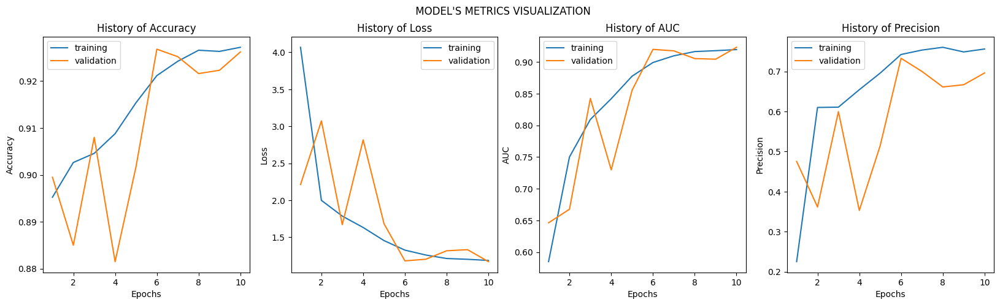

In [ ]:
Train_Val_Plot(history_CNN1.history['accuracy'],history_CNN1.history['val_accuracy'],
               history_CNN1.history['loss'],history_CNN1.history['val_loss'],
               history_CNN1.history['auc'],history_CNN1.history['val_auc'],
               history_CNN1.history['precision'],history_CNN1.history['val_precision']
              )

In [ ]:
scores1 = model_CNN1.evaluate_generator(test_generator)

print("Accuracy = ", scores1[1])
print("Precision = ", scores1[2])
print("Recall = ", scores1[3])
print("AUC = ", scores1[4])

Accuracy =  0.9273499846458435
Precision =  0.7622243762016296
Recall =  0.39750000834465027
AUC =  0.9161085486412048


## Evaluating the Model on Test Data and Saving

After training our tomato disease detection model, it's essential to assess its performance on unseen data to ensure its real-world utility. Additionally, saving the trained model allows us to deploy it for making predictions on new tomato leaf images.

## Evaluating the Model on Test Data

The following code evaluates the trained model on the test data:



In [ ]:
# Make predictions on test data
#test_loss, test_accuracy = model_CNN1.evaluate(test_generator, steps=len(test_generator))
#print(f"Test Loss: {test_loss:.4f}")
#print(f"Test Accuracy: {test_accuracy:.4f}")

# Save the trained model
model_CNN1.save("trained_model_CNN1.h5")
print("Trained model saved as 'trained_model_CNN1.h5'")

Trained model saved as 'trained_model_CNN1.h5'


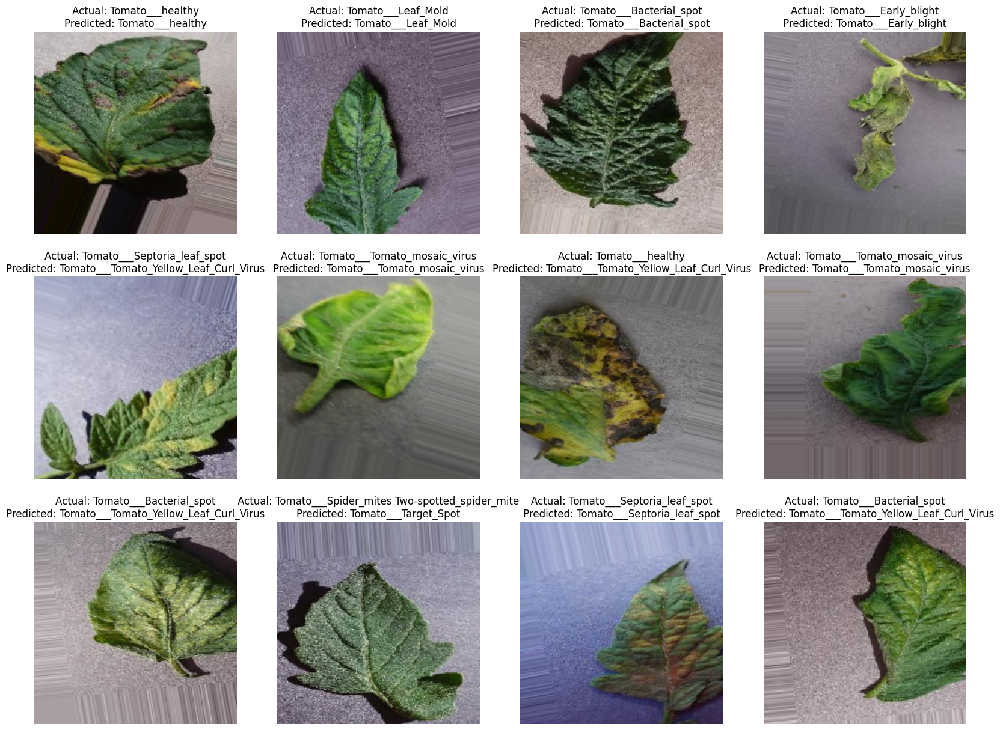

In [ ]:
predictImages(test_generator, classes, model_CNN1)

## Generating and Visualizing the Confusion Matrix

The confusion matrix is a valuable tool for assessing the performance of a classification model, especially in multi-class classification scenarios like our tomato disease detection project. In this section, we'll use the saved model to generate predictions and create a confusion matrix.


1/1 [==============================] - 0s 27ms/step


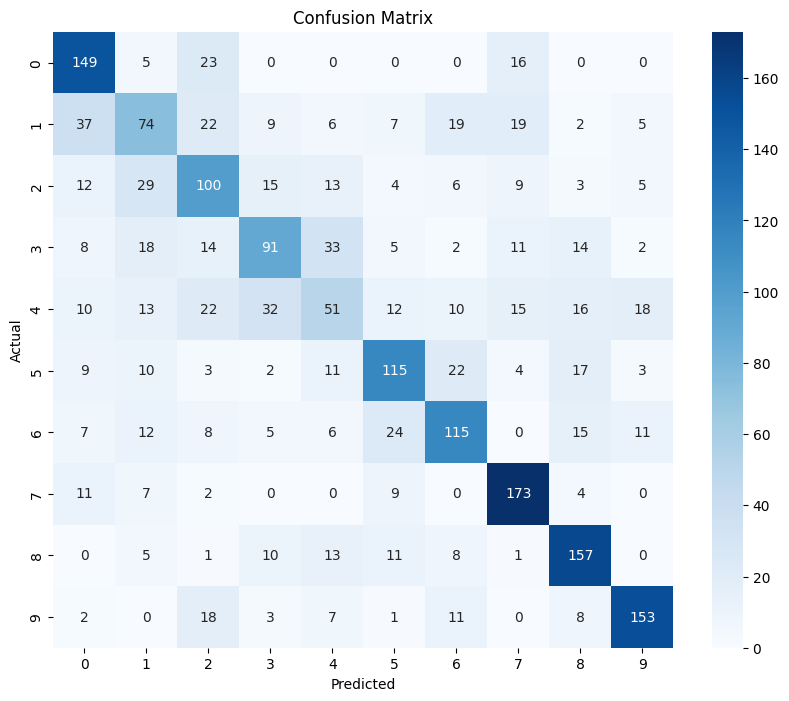

In [ ]:
# Load the saved model
loaded_model = tf.keras.models.load_model("trained_model_CNN1.h5")

# Initialize variables
num_samples = len(test_generator.filenames)
batch_size = 32
num_batches = int(np.ceil(num_samples / batch_size))
all_test_labels = []
all_predicted_labels = []

# Generate predictions in batches
for _ in range(num_batches):
    batch_images, batch_labels = next(test_generator)
    batch_predictions = loaded_model.predict(batch_images)
    batch_predicted_labels = np.argmax(batch_predictions, axis=1)

    all_test_labels.extend(np.argmax(batch_labels, axis=1))
    all_predicted_labels.extend(batch_predicted_labels)

# Generate confusion matrix
cm = confusion_matrix(all_test_labels, all_predicted_labels)

# Plot the confusion matrix
class_names = [str(i) for i in range(num_classes)]  # Replace with actual class names if available
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# MODEL BUILDING : CNN with 2 Convolutional Layer (2 — 2-Conv CNN)

In the heart of our tomato disease detection project lies the neural network model responsible for classifying tomato leaf images. Convolutional Neural Networks (CNNs) are a powerful choice for image classification tasks, and here, we define our CNN model using the Keras library.

Here's a breakdown of the code:

- `num_classes`: We calculate the number of classes (disease categories) based on the number of classes defined in our training data using `train_generator.class_indices`. This value is essential for configuring the output layer of the model.

- `model = Sequential([...])`: We create a sequential model, a linear stack of layers, and define its architecture. Our model consists of the following layers:

    - `Conv2D(32, (3, 3), activation="relu", input_shape=(224, 224, 3))`: The first convolutional layer with 32 filters of size (3, 3), ReLU activation, and input shape (224, 224, 3). This layer extracts features from input images.
    
    - `MaxPooling2D(2, 2)`: Max-pooling layer with a 2x2 pooling window. It reduces spatial dimensions and retains important features.
    
    - `Conv2D(64, (3, 3), activation="relu")`: A second convolutional layer with 64 filters and ReLU activation.
    
    - `MaxPooling2D(2, 2)`: Another max-pooling layer to further reduce spatial dimensions.
    
    - `Flatten()`: This layer flattens the output from the previous layers into a one-dimensional vector.
    
    - `Dense(128, activation="relu")`: A fully connected (dense) layer with 128 neurons and ReLU activation.
    
    - `Dropout(0.5)`: Dropout layer with a dropout rate of 50%. Dropout helps prevent overfitting by randomly deactivating neurons during training.
    
    - `Dense(num_classes, activation="softmax")`: The final dense layer with `num_classes` neurons (equal to the number of disease categories) and softmax activation. This layer produces class probabilities for each category.

This architecture represents a common design for CNNs in image classification tasks.

With the CNN model defined, we're ready to compile it, train it on our dataset, and evaluate its performance in later sections of the notebook.


In [ ]:
# Create a CNN model
#num_classes = len(train_generator.class_indices)
model = Sequential([
    Conv2D(32, (3, 3), activation="relu", input_shape=(224, 224, 3)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation="relu"),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation="relu"),
    Dropout(0.5),
    Dense(num_classes, activation="softmax")
])

## Compiling and Training the CNN Model

With our CNN model architecture defined, it's time to compile and train the model to learn from our tomato disease dataset. In this section, we'll cover the necessary steps for model compilation and training.

- `from tensorflow.keras.optimizers import Adam`: We import the Adam optimizer from the TensorFlow library. The optimizer is responsible for updating the model's weights during training to minimize the loss function.

- `model.compile(...)`: We compile the model by specifying its configuration. Here's what each argument does:
    - `optimizer=Adam(lr=0.0001)`: We choose the Adam optimizer as our optimizer with a learning rate of 0.0001. You can adjust the learning rate based on your experimentation and the specific dataset.
    - `loss="categorical_crossentropy"`: We use categorical cross-entropy as the loss function since this is a multi-class classification problem.
    - `metrics=["accuracy"]`: We specify that we want to track the accuracy metric during training.

- `from tensorflow.keras.callbacks import EarlyStopping`: We import the EarlyStopping callback from TensorFlow. This callback allows us to monitor the model's validation accuracy and stop training early if it stops improving.

- `early_stopping = EarlyStopping(...)`: We define the EarlyStopping callback with the following arguments:
    - `monitor='val_accuracy'`: We monitor the validation accuracy.
    - `patience=5`: Training will stop if there is no improvement in validation accuracy for 5 consecutive epochs.
    - `restore_best_weights=True`: After early stopping, the model's weights will be restored to the best weights obtained during training.

- `model.fit(...)`: We train the model using the `fit` method. The arguments are as follows:
    - `train_generator` and `valid_generator`: These are the data generators we created earlier for the training and validation datasets.
    - `steps_per_epoch` and `validation_steps`: These parameters are set to the number of batches in the training and validation generators, respectively.
    - `epochs=50`: We specify the maximum number of training epochs. The training may stop earlier if the EarlyStopping criteria are met.
    - `callbacks=[early_stopping]`: We include the EarlyStopping callback to monitor and control training.

With this setup, our CNN model will be trained on the tomato disease dataset, and the training will stop early if validation accuracy does not improve for a defined number of epochs. This helps prevent overfitting and ensures that we have the best-performing model.


In [ ]:
# Compile the model with Adam optimizer
model.compile(
    optimizer=Adam(lr=0.0001),  # You can adjust the learning rate as needed
    loss="categorical_crossentropy",
    #metrics=["accuracy"],
    metrics=METRICS
)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)

# Train the model with EarlyStopping
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=10, # epoch = 50
    validation_data=valid_generator,
    validation_steps=len(valid_generator),
    callbacks=[early_stopping]  # Add the EarlyStopping callback
)

Epoch 1/10
250/250 [==============================] - 104s 405ms/step - loss: 2.0125 - accuracy: 0.9089 - precision: 0.6901 - recall: 0.1623 - auc: 0.7952 - val_loss: 1.5400 - val_accuracy: 0.9104 - val_precision: 0.5977 - val_recall: 0.3180 - val_auc: 0.8682
Epoch 2/10
250/250 [==============================] - 94s 376ms/step - loss: 1.3507 - accuracy: 0.9202 - precision: 0.7372 - recall: 0.3142 - auc: 0.8950 - val_loss: 1.5582 - val_accuracy: 0.9131 - val_precision: 0.5982 - val_recall: 0.3990 - val_auc: 0.8764
Epoch 3/10
250/250 [==============================] - 95s 379ms/step - loss: 1.1826 - accuracy: 0.9273 - precision: 0.7617 - recall: 0.3980 - auc: 0.9208 - val_loss: 1.5396 - val_accuracy: 0.9158 - val_precision: 0.6008 - val_recall: 0.4710 - val_auc: 0.8925
Epoch 4/10
250/250 [==============================] - 95s 381ms/step - loss: 1.1235 - accuracy: 0.9306 - precision: 0.7684 - recall: 0.4387 - auc: 0.9288 - val_loss: 1.0927 - val_accuracy: 0.9331 - val_precision: 0.7210 - 

## Visualizing Training Progress

Monitoring the training progress of our machine learning model is crucial for assessing its performance and identifying potential issues like overfitting. In this section, we'll visualize the training and validation accuracy and loss using Matplotlib.

## Training and Validation Accuracy Plot

The following code plots the training and validation accuracy over epochs:


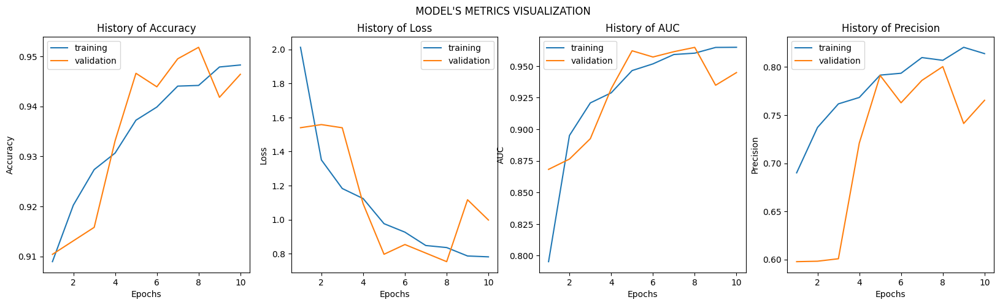

In [ ]:
Train_Val_Plot(history.history['accuracy'],history.history['val_accuracy'],
               history.history['loss'],history.history['val_loss'],
               history.history['auc'],history.history['val_auc'],
               history.history['precision'],history.history['val_precision']
              )

In [ ]:
scores2 = model.evaluate_generator(test_generator)

print("Accuracy = ", scores2[1])
print("Precision = ", scores2[2])
print("Recall = ", scores2[3])
print("AUC = ", scores2[4])

Accuracy =  0.9622499942779541
Precision =  0.8821362853050232
Recall =  0.718500018119812
AUC =  0.9840005040168762


## Evaluating the Model on Test Data and Saving

After training our tomato disease detection model, it's essential to assess its performance on unseen data to ensure its real-world utility. Additionally, saving the trained model allows us to deploy it for making predictions on new tomato leaf images.

## Evaluating the Model on Test Data

The following code evaluates the trained model on the test data:



In [ ]:
# Save the trained model
model.save("trained_model.h5")
print("Trained model saved as 'trained_model.h5'")

Trained model saved as 'trained_model.h5'


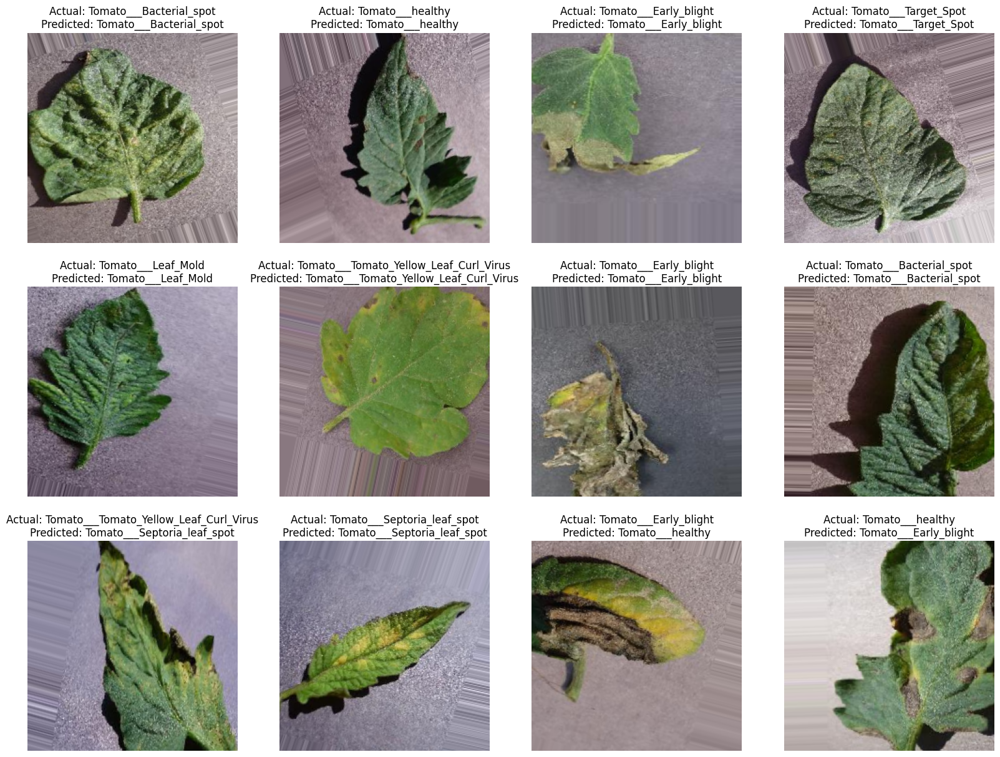

In [ ]:
predictImages(test_generator, classes, model)

## Generating and Visualizing the Confusion Matrix

The confusion matrix is a valuable tool for assessing the performance of a classification model, especially in multi-class classification scenarios like our tomato disease detection project. In this section, we'll use the saved model to generate predictions and create a confusion matrix.


1/1 [==============================] - 0s 27ms/step


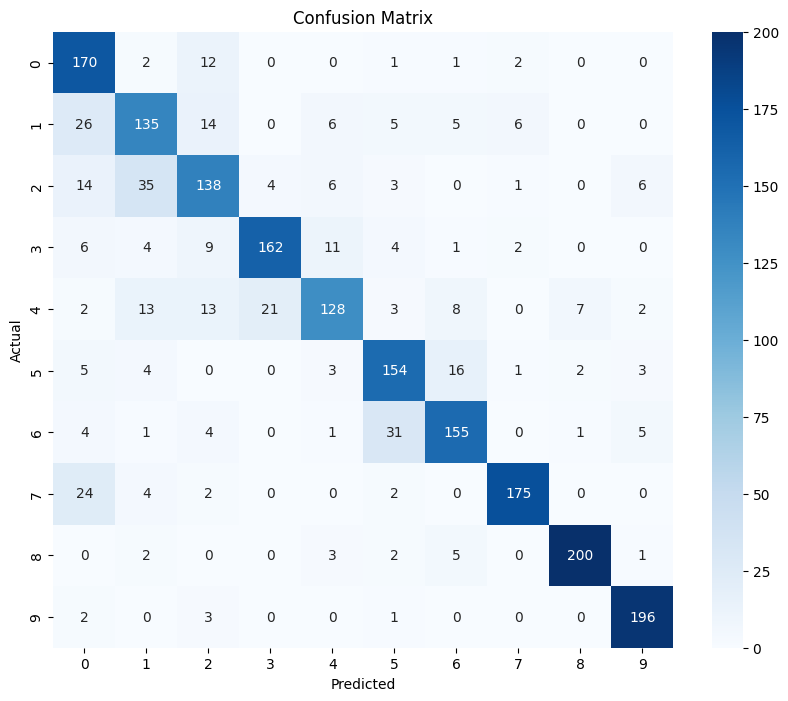

In [ ]:

# Load the saved model
loaded_model = tf.keras.models.load_model("trained_model.h5")

# Initialize variables
num_samples = len(test_generator.filenames)
batch_size = 32
num_batches = int(np.ceil(num_samples / batch_size))
all_test_labels = []
all_predicted_labels = []

# Generate predictions in batches
for _ in range(num_batches):
    batch_images, batch_labels = next(test_generator)
    batch_predictions = loaded_model.predict(batch_images)
    batch_predicted_labels = np.argmax(batch_predictions, axis=1)

    all_test_labels.extend(np.argmax(batch_labels, axis=1))
    all_predicted_labels.extend(batch_predicted_labels)

# Generate confusion matrix
cm = confusion_matrix(all_test_labels, all_predicted_labels)

# Plot the confusion matrix
class_names = [str(i) for i in range(num_classes)]  # Replace with actual class names if available
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Pretrained Model - VGG19 Implementation

In [ ]:
vgg = VGG19(input_shape= (224,224,3), weights='imagenet', include_top=False)
for layer in vgg.layers:
    layer.trainable = False
x = Flatten()(vgg.output)

prediction = Dense(10, activation='softmax')(x)

modelvgg = Model(inputs=vgg.input, outputs=prediction)
modelvgg.summary()

80134624/80134624 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

In [ ]:
modelvgg.compile(optimizer='adam',
loss=tf.losses.CategoricalCrossentropy(),
#loss="categorical_crossentropy",
metrics=METRICS)
#metrics=[keras.metrics.AUC(name='auc')])
callback = keras.callbacks.EarlyStopping(monitor='val_loss',
                                            patience=8,
                                            restore_best_weights=True)

In [ ]:
history_modelvgg = modelvgg.fit(train_generator,
                                epochs=10,
                                validation_data=valid_generator,
                                callbacks=callback)

Epoch 1/10
250/250 [==============================] - 111s 419ms/step - loss: 1.3139 - accuracy: 0.9344 - precision: 0.7613 - recall: 0.5017 - auc: 0.9211 - val_loss: 1.0645 - val_accuracy: 0.9406 - val_precision: 0.7476 - val_recall: 0.6130 - val_auc: 0.9364
Epoch 2/10
250/250 [==============================] - 103s 412ms/step - loss: 0.8816 - accuracy: 0.9460 - precision: 0.7819 - recall: 0.6385 - auc: 0.9546 - val_loss: 0.7937 - val_accuracy: 0.9514 - val_precision: 0.7927 - val_recall: 0.6960 - val_auc: 0.9634
Epoch 3/10
250/250 [==============================] - 103s 410ms/step - loss: 0.8028 - accuracy: 0.9501 - precision: 0.7902 - recall: 0.6817 - auc: 0.9622 - val_loss: 0.8433 - val_accuracy: 0.9499 - val_precision: 0.7757 - val_recall: 0.7020 - val_auc: 0.9597
Epoch 4/10
250/250 [==============================] - 102s 409ms/step - loss: 0.7336 - accuracy: 0.9551 - precision: 0.8095 - recall: 0.7209 - auc: 0.9676 - val_loss: 0.8062 - val_accuracy: 0.9530 - val_precision: 0.7807

## Visualizing Training Progress

Monitoring the training progress of our machine learning model is crucial for assessing its performance and identifying potential issues like overfitting. In this section, we'll visualize the training and validation accuracy and loss using Matplotlib.

## Training and Validation Accuracy Plot

The following code plots the training and validation accuracy over epochs:

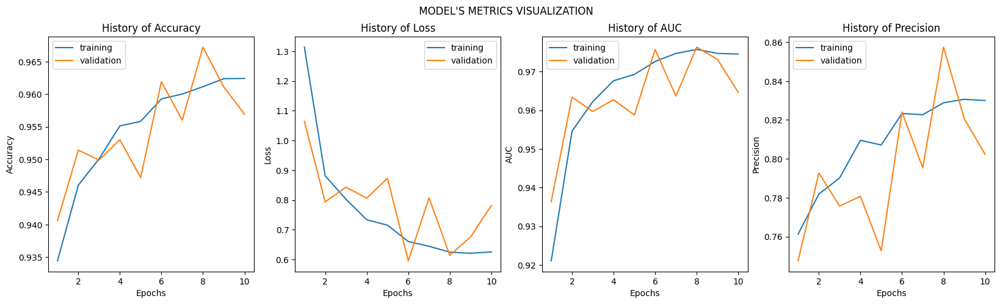

In [ ]:
Train_Val_Plot(history_modelvgg.history['accuracy'],history_modelvgg.history['val_accuracy'],
               history_modelvgg.history['loss'],history_modelvgg.history['val_loss'],
               history_modelvgg.history['auc'],history_modelvgg.history['val_auc'],
               history_modelvgg.history['precision'],history_modelvgg.history['val_precision']
              )

In [ ]:
scores4 = modelvgg.evaluate_generator(test_generator)

print("Accuracy = ", scores4[1])
print("Precision = ", scores4[2])
print("Recall = ", scores4[3])
print("AUC = ", scores4[4])

Accuracy =  0.9589499831199646
Precision =  0.8150721788406372
Recall =  0.762499988079071
AUC =  0.9697312116622925


## Evaluating the Model on Test Data and Saving

After training our tomato disease detection model, it's essential to assess its performance on unseen data to ensure its real-world utility. Additionally, saving the trained model allows us to deploy it for making predictions on new tomato leaf images.

## Evaluating the Model on Test Data

The following code evaluates the trained model on the test data:



In [ ]:
# Save the trained model
modelvgg.save("trained_model_vgg.h5")
print("Trained model saved as 'trained_model_vgg.h5'")

Trained model saved as 'trained_model_vgg.h5'


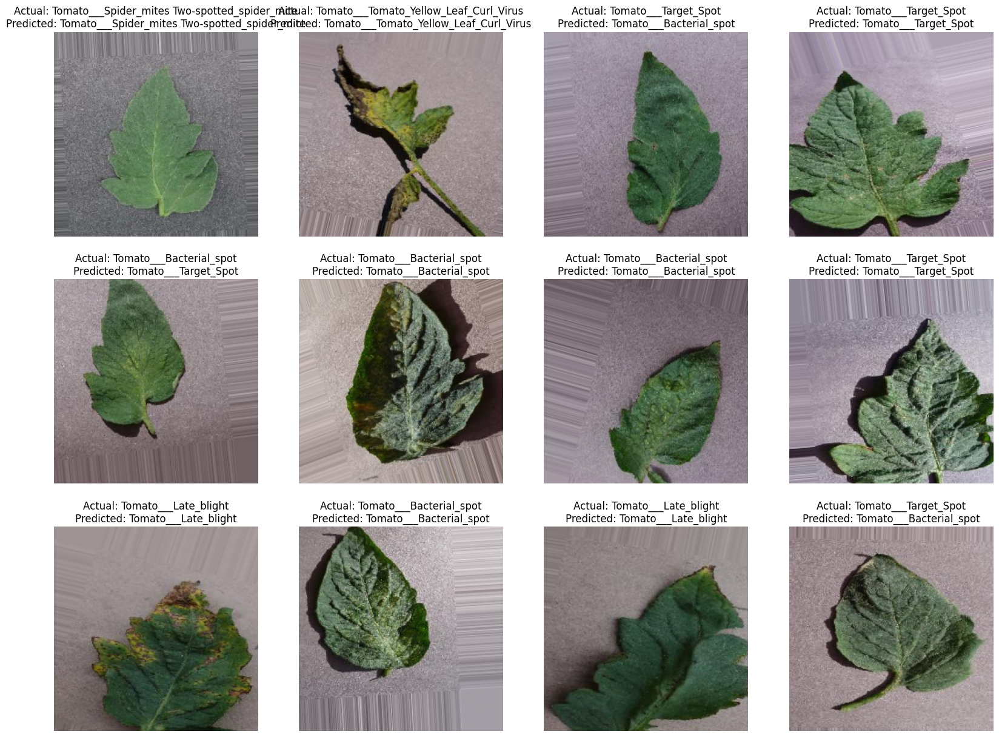

In [ ]:
predictImages(test_generator, classes, modelvgg)

## Generating and Visualizing the Confusion Matrix

The confusion matrix is a valuable tool for assessing the performance of a classification model, especially in multi-class classification scenarios like our tomato disease detection project. In this section, we'll use the saved model to generate predictions and create a confusion matrix.


1/1 [==============================] - 0s 28ms/step


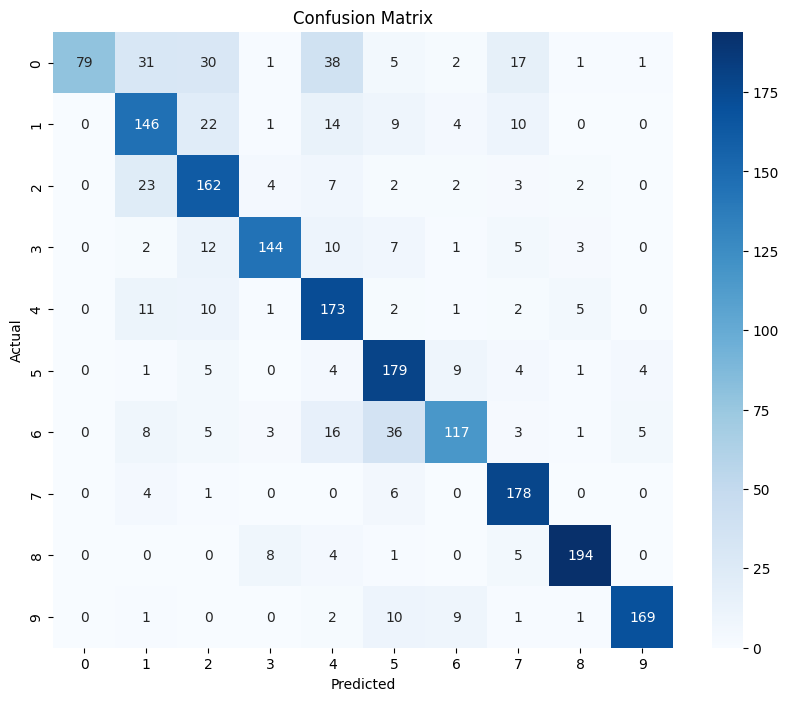

In [ ]:
# Load the saved model
loaded_model = tf.keras.models.load_model("trained_model_vgg.h5")

# Initialize variables
num_samples = len(test_generator.filenames)
batch_size = 32
num_batches = int(np.ceil(num_samples / batch_size))
all_test_labels = []
all_predicted_labels = []

# Generate predictions in batches
for _ in range(num_batches):
    batch_images, batch_labels = next(test_generator)
    batch_predictions = loaded_model.predict(batch_images)
    batch_predicted_labels = np.argmax(batch_predictions, axis=1)

    all_test_labels.extend(np.argmax(batch_labels, axis=1))
    all_predicted_labels.extend(batch_predicted_labels)

# Generate confusion matrix
cm = confusion_matrix(all_test_labels, all_predicted_labels)

# Plot the confusion matrix
class_names = [str(i) for i in range(num_classes)]  # Replace with actual class names if available
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Pretrained Model - ResNet Implementation

In [ ]:
from tensorflow import keras
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model

In [ ]:
# Function to initialize model (ResNet152V2)

def get_model():

    base_model = ResNet152V2(input_shape=(224,224,3), include_top=False)

    for layers in base_model.layers[:140]:
        layers.trainable = False
    for layers in base_model.layers[140:]:
        layers.trainable = True


    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(1000, activation='relu')(x)
    pred = Dense(10, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=pred)

    return model

In [ ]:
# Model initialization
model_resNet = get_model()
model_resNet.summary()

234545216/234545216 [==============================] - 1s 0us/step
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 pool1_pad (ZeroPadding2D)   (None, 114, 114, 64)         0         ['conv1_conv[0][0]']          
                         

In [ ]:
# Model training
model_resNet.compile(loss='categorical_crossentropy',
                     optimizer='sgd',
                     metrics=METRICS)

In [ ]:
history_resNet = model_resNet.fit(train_generator,
                 batch_size=batch_size,
                 epochs=10,
                 validation_data=valid_generator)

Epoch 1/10
250/250 [==============================] - 159s 635ms/step - loss: 0.0766 - accuracy: 0.9950 - precision: 0.9780 - recall: 0.9721 - auc: 0.9994 - val_loss: 0.1766 - val_accuracy: 0.9898 - val_precision: 0.9517 - val_recall: 0.9460 - val_auc: 0.9943
Epoch 2/10
250/250 [==============================] - 158s 631ms/step - loss: 0.0710 - accuracy: 0.9953 - precision: 0.9787 - recall: 0.9743 - auc: 0.9993 - val_loss: 0.1008 - val_accuracy: 0.9930 - val_precision: 0.9697 - val_recall: 0.9600 - val_auc: 0.9985
Epoch 3/10
250/250 [==============================] - 158s 632ms/step - loss: 0.0579 - accuracy: 0.9963 - precision: 0.9837 - recall: 0.9794 - auc: 0.9995 - val_loss: 0.1204 - val_accuracy: 0.9927 - val_precision: 0.9668 - val_recall: 0.9600 - val_auc: 0.9978
Epoch 4/10
250/250 [==============================] - 158s 631ms/step - loss: 0.0468 - accuracy: 0.9973 - precision: 0.9873 - recall: 0.9852 - auc: 0.9996 - val_loss: 0.1394 - val_accuracy: 0.9919 - val_precision: 0.9618

## Visualizing Training Progress

Monitoring the training progress of our machine learning model is crucial for assessing its performance and identifying potential issues like overfitting. In this section, we'll visualize the training and validation accuracy and loss using Matplotlib.

## Training and Validation Accuracy Plot

The following code plots the training and validation accuracy over epochs:


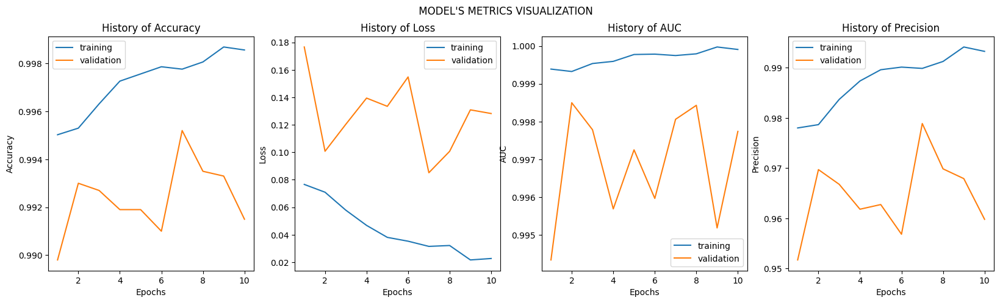

In [ ]:
Train_Val_Plot(history_resNet.history['accuracy'],history_resNet.history['val_accuracy'],
               history_resNet.history['loss'],history_resNet.history['val_loss'],
               history_resNet.history['auc'],history_resNet.history['val_auc'],
               history_resNet.history['precision'],history_resNet.history['val_precision']
              )

In [ ]:
scores3 = model_resNet.evaluate_generator(test_generator)

print("Accuracy = ", scores3[1])
print("Precision = ", scores3[2])
print("Recall = ", scores3[3])
print("AUC = ", scores3[4])

Accuracy =  0.996749997138977
Precision =  0.9854490756988525
Recall =  0.9819999933242798
AUC =  0.9990323185920715


## Evaluating the Model on Test Data and Saving

After training our tomato disease detection model, it's essential to assess its performance on unseen data to ensure its real-world utility. Additionally, saving the trained model allows us to deploy it for making predictions on new tomato leaf images.

## Evaluating the Model on Test Data

The following code evaluates the trained model on the test data:



In [ ]:
# Save the trained model
model_resNet.save("trained_model_resNet.h5")
print("Trained model saved as 'trained_model_resNet.h5'")

Trained model saved as 'trained_model_resNet.h5'


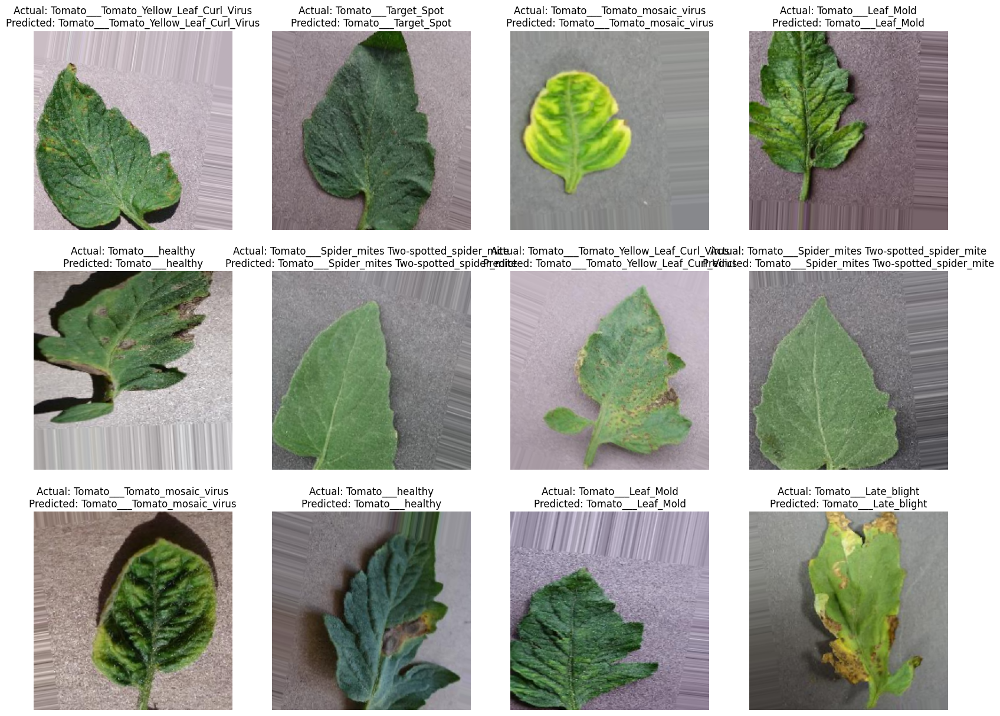

In [ ]:
predictImages(test_generator, classes, model_resNet)

## Generating and Visualizing the Confusion Matrix

The confusion matrix is a valuable tool for assessing the performance of a classification model, especially in multi-class classification scenarios like our tomato disease detection project. In this section, we'll use the saved model to generate predictions and create a confusion matrix.


1/1 [==============================] - 0s 40ms/step


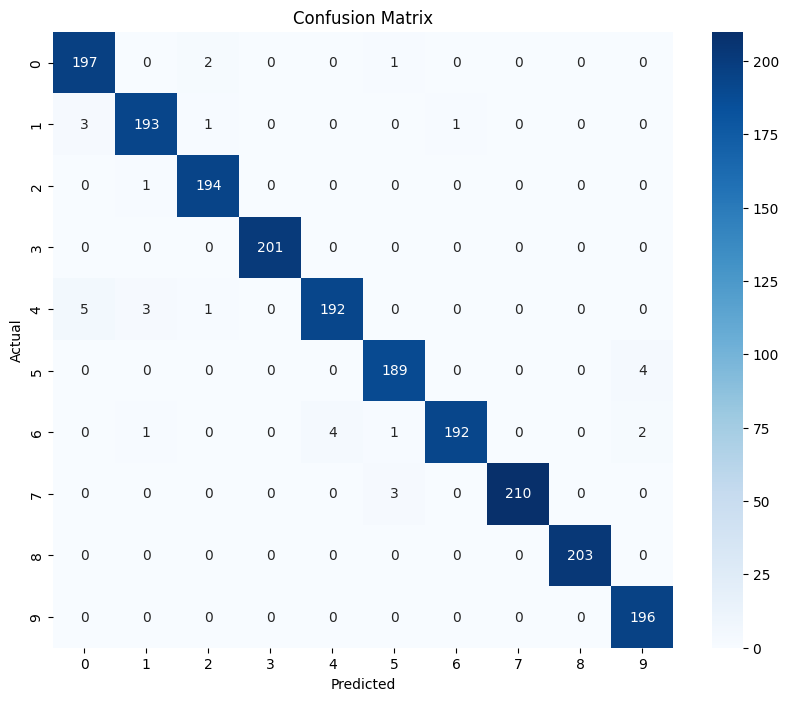

In [ ]:
# Load the saved model
loaded_model = tf.keras.models.load_model("trained_model_resNet.h5")

# Initialize variables
num_samples = len(test_generator.filenames)
batch_size = 32
num_batches = int(np.ceil(num_samples / batch_size))
all_test_labels = []
all_predicted_labels = []

# Generate predictions in batches
for _ in range(num_batches):
    batch_images, batch_labels = next(test_generator)
    batch_predictions = loaded_model.predict(batch_images)
    batch_predicted_labels = np.argmax(batch_predictions, axis=1)

    all_test_labels.extend(np.argmax(batch_labels, axis=1))
    all_predicted_labels.extend(batch_predicted_labels)

# Generate confusion matrix
cm = confusion_matrix(all_test_labels, all_predicted_labels)

# Plot the confusion matrix
class_names = [str(i) for i in range(num_classes)]  # Replace with actual class names if available
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Pretrained Model - EfficientNet Implementation

In [ ]:
from tensorflow.keras.applications import EfficientNetB4

In [ ]:
backbone = EfficientNetB4(
    input_shape=(224, 224, 3),
    include_top=False  # not including a final layers of EfficientNetB2
)

model_effNet = tf.keras.Sequential([
    backbone,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(10, activation='softmax')
])

model_effNet.summary()

71686520/71686520 [==============================] - 0s 0us/step
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb4 (Functional  (None, 7, 7, 1792)        17673823  
 )                                                               
                                                                 
 global_average_pooling2d_1  (None, 1792)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dropout_2 (Dropout)         (None, 1792)              0         
                                                                 
 dense_7 (Dense)             (None, 128)               229504    
                                                                 
 dense_8 (Dense)             (None, 10)                1290      
                                                       

In [ ]:
# Compiling your model by providing the Optimizer , Loss and Metrics
model_effNet.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07),
    loss = 'categorical_crossentropy',
    metrics=METRICS
)

In [ ]:
# Train the model
history_effNet = model_effNet.fit(
    train_generator,
    steps_per_epoch= len(train_generator),
    epochs=10,
    validation_data=valid_generator,
     validation_steps=len(valid_generator)
)

Epoch 1/10
250/250 [==============================] - 174s 695ms/step - loss: 0.3832 - accuracy: 0.9766 - precision: 0.9043 - recall: 0.8565 - auc: 0.9889 - val_loss: 4.8334 - val_accuracy: 0.8337 - val_precision: 0.0952 - val_recall: 0.0780 - val_auc: 0.5071
Epoch 2/10
250/250 [==============================] - 169s 674ms/step - loss: 0.2086 - accuracy: 0.9871 - precision: 0.9433 - recall: 0.9270 - auc: 0.9954 - val_loss: 3.7188 - val_accuracy: 0.8687 - val_precision: 0.1889 - val_recall: 0.0950 - val_auc: 0.4976
Epoch 3/10
250/250 [==============================] - 169s 675ms/step - loss: 0.1355 - accuracy: 0.9914 - precision: 0.9621 - recall: 0.9511 - auc: 0.9977 - val_loss: 5.3726 - val_accuracy: 0.8523 - val_precision: 0.2382 - val_recall: 0.2170 - val_auc: 0.5648
Epoch 4/10
250/250 [==============================] - 169s 674ms/step - loss: 0.1139 - accuracy: 0.9930 - precision: 0.9678 - recall: 0.9622 - auc: 0.9979 - val_loss: 4.2151 - val_accuracy: 0.8201 - val_precision: 0.1001

## Visualizing Training Progress

Monitoring the training progress of our machine learning model is crucial for assessing its performance and identifying potential issues like overfitting. In this section, we'll visualize the training and validation accuracy and loss using Matplotlib.

## Training and Validation Accuracy Plot

The following code plots the training and validation accuracy over epochs:


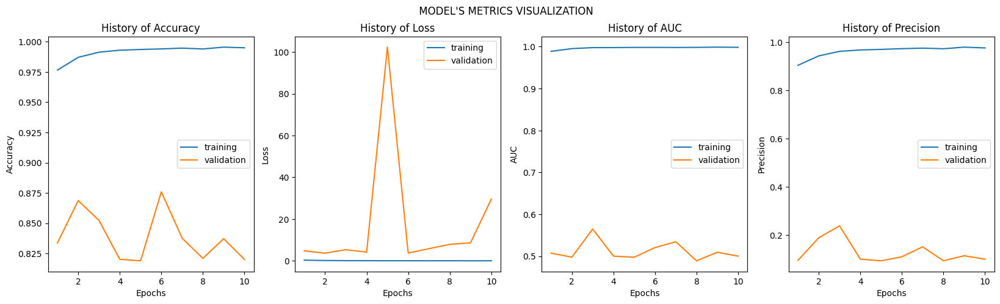

In [ ]:
Train_Val_Plot(history_effNet.history['accuracy'],history_effNet.history['val_accuracy'],
               history_effNet.history['loss'],history_effNet.history['val_loss'],
               history_effNet.history['auc'],history_effNet.history['val_auc'],
               history_effNet.history['precision'],history_effNet.history['val_precision']
              )

In [ ]:
scores5 = model_effNet.evaluate_generator(test_generator)

print("Accuracy = ", scores5[1])
print("Precision = ", scores5[2])
print("Recall = ", scores5[3])
print("AUC = ", scores5[4])

Accuracy =  0.8199999928474426
Precision =  0.10000000149011612
Recall =  0.10000000149011612
AUC =  0.5


## Evaluating the Model on Test Data and Saving

After training our tomato disease detection model, it's essential to assess its performance on unseen data to ensure its real-world utility. Additionally, saving the trained model allows us to deploy it for making predictions on new tomato leaf images.

## Evaluating the Model on Test Data

The following code evaluates the trained model on the test data:



In [ ]:
# Save the trained model
model_effNet.save("trained_model_effNet.h5")
print("Trained model saved as 'trained_model_effNet.h5'")

Trained model saved as 'trained_model_effNet.h5'


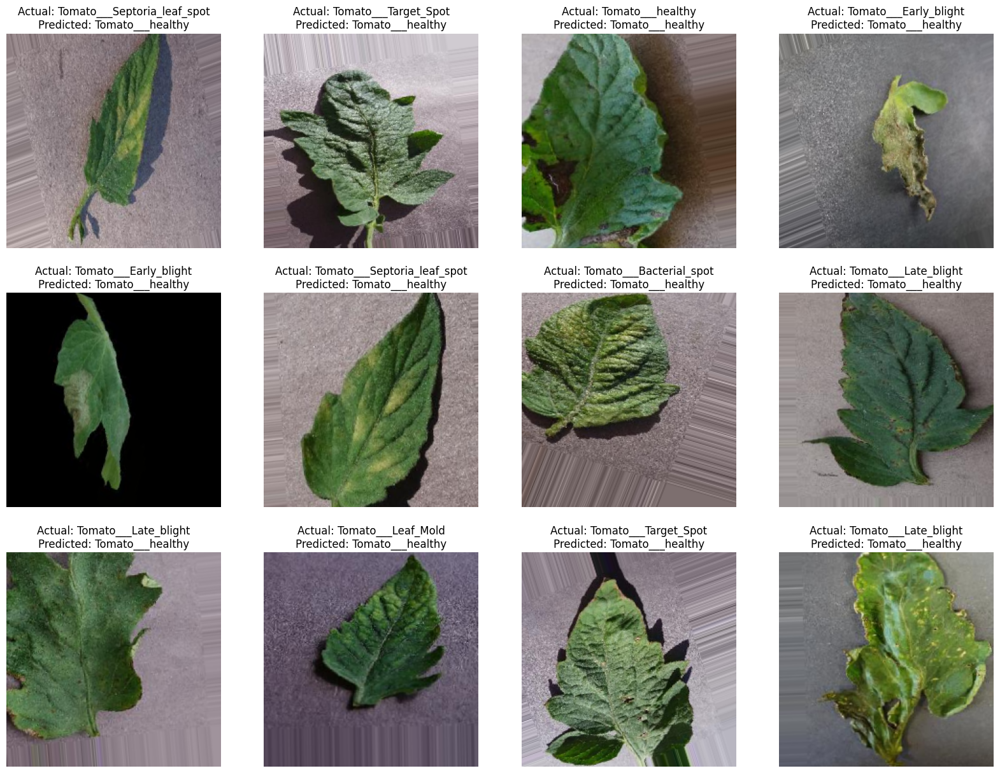

In [ ]:
predictImages(test_generator, classes, model_effNet)

## Generating and Visualizing the Confusion Matrix

The confusion matrix is a valuable tool for assessing the performance of a classification model, especially in multi-class classification scenarios like our tomato disease detection project. In this section, we'll use the saved model to generate predictions and create a confusion matrix.


1/1 [==============================] - 0s 39ms/step


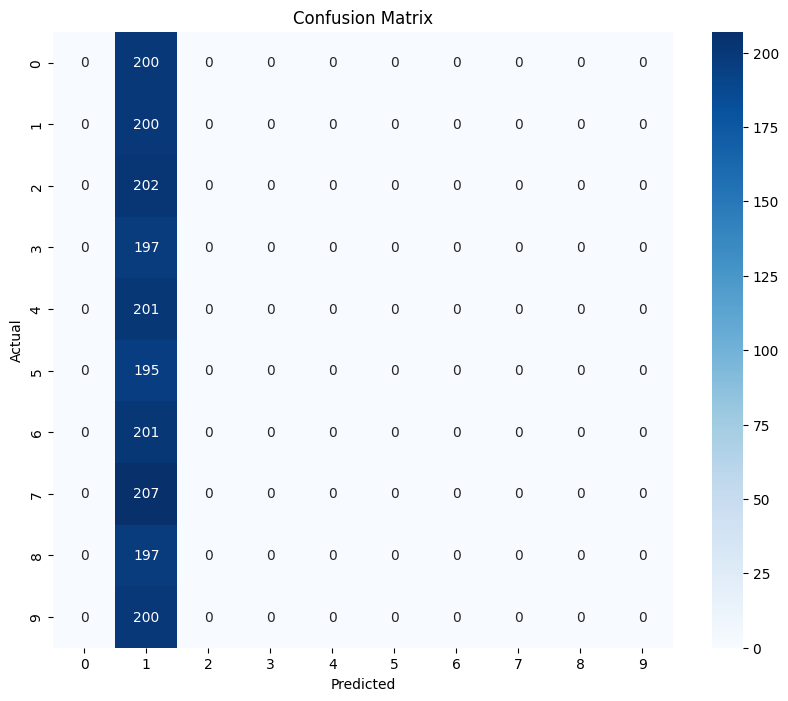

In [ ]:
# Load the saved model
loaded_model = tf.keras.models.load_model("trained_model_effNet.h5")

# Initialize variables
num_samples = len(test_generator.filenames)
batch_size = 32
num_batches = int(np.ceil(num_samples / batch_size))
all_test_labels = []
all_predicted_labels = []

# Generate predictions in batches
for _ in range(num_batches):
    batch_images, batch_labels = next(test_generator)
    batch_predictions = loaded_model.predict(batch_images)
    batch_predicted_labels = np.argmax(batch_predictions, axis=1)

    all_test_labels.extend(np.argmax(batch_labels, axis=1))
    all_predicted_labels.extend(batch_predicted_labels)

# Generate confusion matrix
cm = confusion_matrix(all_test_labels, all_predicted_labels)

# Plot the confusion matrix
class_names = [str(i) for i in range(num_classes)]  # Replace with actual class names if available
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Pretrained Model - InceptionV3 Implementation

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
from keras.callbacks import EarlyStopping as ES

In [ ]:
def get_model():

    base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

    for layers in base_model.layers:
        layers.trainable = False

    base_model_output = base_model.output

    x = Flatten()(base_model_output)
    x = Dense(512, activation='relu')(x)
    x = Dense(len(class_names), activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=x)
    return model

In [ ]:
model_Inc = get_model()

model_Inc.compile(loss="categorical_crossentropy",
             optimizer="sgd",
             metrics=METRICS)

model_Inc.summary()

87910968/87910968 [==============================] - 1s 0us/step
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv2d_3 (Conv2D)           (None, 111, 111, 32)         864       ['input_4[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 111, 111, 32)         96        ['conv2d_3[0][0]']            
 Normalization)                                                                                   
                                                                                                  
 activation_1 (Activation) 

In [ ]:
# Train the model

history_IncNet = model_Inc.fit(train_generator,
                   validation_data=valid_generator,
                   epochs=10,
                   steps_per_epoch=len(train_generator),
                   validation_steps=len(valid_generator),
                   callbacks=[ES(monitor="val_loss", patience=5)])

Epoch 1/10
250/250 [==============================] - 114s 432ms/step - loss: 2.0088 - accuracy: 0.8965 - precision: 0.4677 - recall: 0.2514 - auc: 0.7429 - val_loss: 1.0295 - val_accuracy: 0.9338 - val_precision: 0.7700 - val_recall: 0.4820 - val_auc: 0.9405
Epoch 2/10
250/250 [==============================] - 95s 382ms/step - loss: 0.9352 - accuracy: 0.9410 - precision: 0.7807 - recall: 0.5704 - auc: 0.9492 - val_loss: 1.0057 - val_accuracy: 0.9359 - val_precision: 0.7340 - val_recall: 0.5630 - val_auc: 0.9431
Epoch 3/10
250/250 [==============================] - 96s 384ms/step - loss: 0.8017 - accuracy: 0.9485 - precision: 0.7967 - recall: 0.6511 - auc: 0.9620 - val_loss: 0.9798 - val_accuracy: 0.9375 - val_precision: 0.7318 - val_recall: 0.5920 - val_auc: 0.9470
Epoch 4/10
250/250 [==============================] - 96s 385ms/step - loss: 0.7117 - accuracy: 0.9542 - precision: 0.8242 - recall: 0.6891 - auc: 0.9700 - val_loss: 0.8375 - val_accuracy: 0.9444 - val_precision: 0.7612 - 

## Visualizing Training Progress

Monitoring the training progress of our machine learning model is crucial for assessing its performance and identifying potential issues like overfitting. In this section, we'll visualize the training and validation accuracy and loss using Matplotlib.

## Training and Validation Accuracy Plot

The following code plots the training and validation accuracy over epochs:


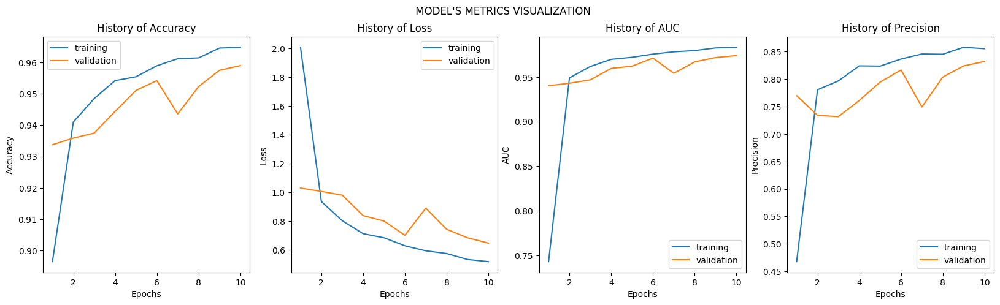

In [ ]:
Train_Val_Plot(history_IncNet.history['accuracy'],history_IncNet.history['val_accuracy'],
               history_IncNet.history['loss'],history_IncNet.history['val_loss'],
               history_IncNet.history['auc'],history_IncNet.history['val_auc'],
               history_IncNet.history['precision'],history_IncNet.history['val_precision']
              )

In [ ]:
scores6 = model_Inc.evaluate_generator(test_generator)

print("Accuracy = ", scores6[1])
print("Precision = ", scores6[2])
print("Recall = ", scores6[3])
print("AUC = ", scores6[4])

Accuracy =  0.9635499715805054
Precision =  0.8501377701759338
Recall =  0.7714999914169312
AUC =  0.9772206544876099


## Evaluating the Model on Test Data and Saving

After training our tomato disease detection model, it's essential to assess its performance on unseen data to ensure its real-world utility. Additionally, saving the trained model allows us to deploy it for making predictions on new tomato leaf images.

## Evaluating the Model on Test Data

The following code evaluates the trained model on the test data:



In [ ]:
# Save the trained model
model_Inc.save("trained_model_IncNet.h5")
print("Trained model saved as 'trained_model_IncNet.h5'")

Trained model saved as 'trained_model_IncNet.h5'


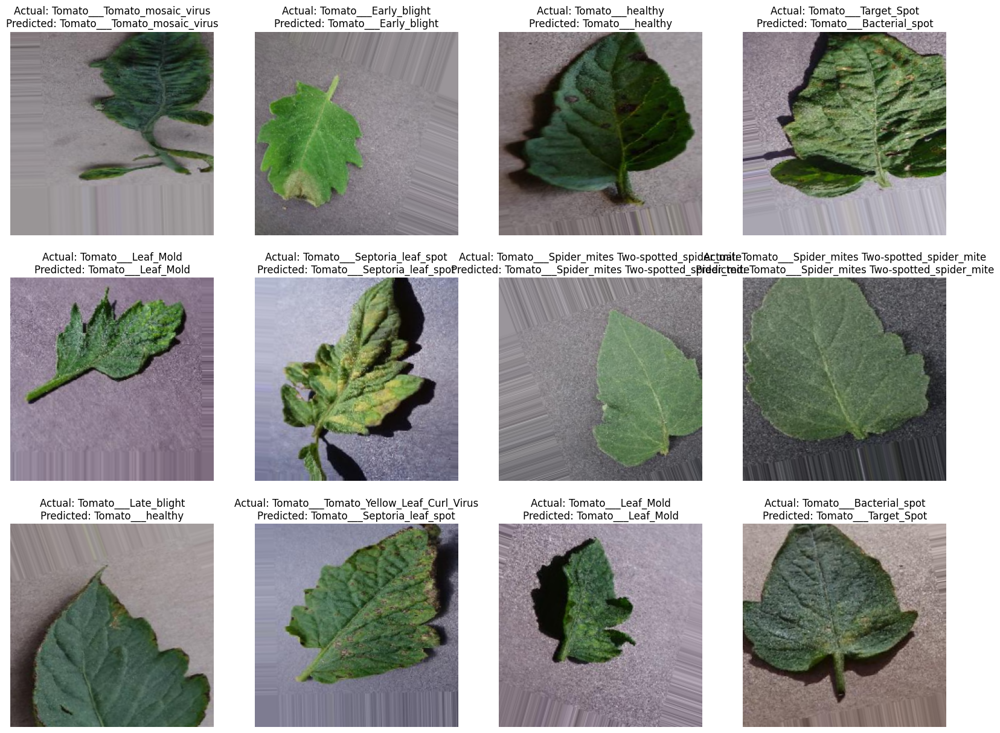

In [ ]:
predictImages(test_generator, classes, model_Inc)

## Generating and Visualizing the Confusion Matrix

The confusion matrix is a valuable tool for assessing the performance of a classification model, especially in multi-class classification scenarios like our tomato disease detection project. In this section, we'll use the saved model to generate predictions and create a confusion matrix.


1/1 [==============================] - 0s 34ms/step


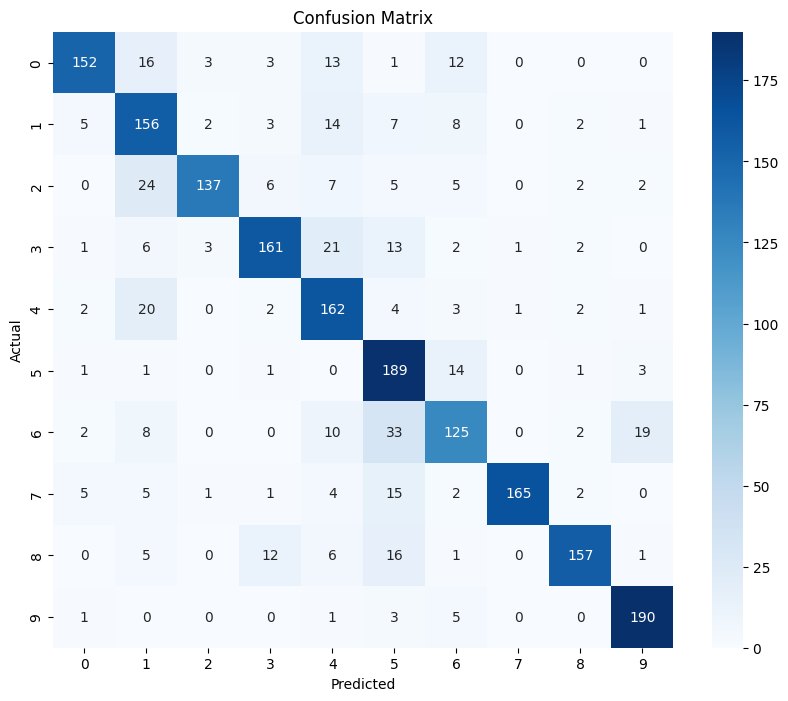

In [ ]:
# Load the saved model
loaded_model = tf.keras.models.load_model("trained_model_IncNet.h5")

# Initialize variables
num_samples = len(test_generator.filenames)
batch_size = 32
num_batches = int(np.ceil(num_samples / batch_size))
all_test_labels = []
all_predicted_labels = []

# Generate predictions in batches
for _ in range(num_batches):
    batch_images, batch_labels = next(test_generator)
    batch_predictions = loaded_model.predict(batch_images)
    batch_predicted_labels = np.argmax(batch_predictions, axis=1)

    all_test_labels.extend(np.argmax(batch_labels, axis=1))
    all_predicted_labels.extend(batch_predicted_labels)

# Generate confusion matrix
cm = confusion_matrix(all_test_labels, all_predicted_labels)

# Plot the confusion matrix
class_names = [str(i) for i in range(num_classes)]  # Replace with actual class names if available
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()